In [1]:
import socnet as sn
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

sn.graph_width = 800
sn.graph_height = 450

sn.node_size = 20
sn.node_color = (255, 255, 255)

sn.edge_width = 2
sn.edge_color = (0, 0, 0)

sn.node_label_position = 'middle center'
sn.edge_label_distance = 10

lista_paises_chegaram = []
lista_paises_sairam = []

posicao_paises_sairam = {}
posicao_paises_chegaram = {}

In [2]:
pop = pd.read_csv('population.csv', index_col=None)

## Abaixo explicaremos os calculos feitos para o ano de 1970. Para o resto dos anos, os calculos se repetem

In [3]:
G1970 = sn.load_graph('year_1970.gml')

sn.show_graph(G1970, nlab=True)

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:59: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:187: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:190: RuntimeWarning:

invalid value encountered in double_scalars



In [4]:
## Variáveis para medição de in_degree e out_degree

maior_out_degree = 0 
maior_in_degree = 0
pais_maior_in_degree = []
pais_maior_out_degree = []

## Variáveis para análise dos successors

soma_pessoas_que_sairam = 0
pais_mais_saiu_pessoas_no = 0
pais_mais_saiu_pessoas = ""
lista_numero_pessoas_sairam = []

## Variáveis para análise dos predecessors

soma_pessoas_que_chegaram = 0
pais_mais_chegou_pessoas_no = 0
pais_mais_chegou_pessoas = ""
lista_numero_pessoas_chegaram  = []
lista_nome_paises_sairam = []

g = G1970
year = 1970

for n in g.nodes:
    
    ## calcula indregree e out dregee máximo
    if g.in_degree(n) > maior_in_degree:
        maior_in_degree = g.in_degree(n)
        pais_maior_in_degree = [g.nodes[n]['label']]
        
    elif g.in_degree(n) == maior_in_degree:
        pais_maior_in_degree.append(g.nodes[n]['label'])
        
    if g.out_degree(n) > maior_out_degree:
        maior_out_degree = g.out_degree(n)
        pais_maior_out_degree = [g.nodes[n]['label']]
        
    elif g.out_degree(n) == maior_out_degree:
        pais_maior_out_degree.append(g.nodes[n]['label'])
    
    
    ## analisa quando pessoas saíram no total de cada país
    for i in g.successors(n):
        soma_pessoas_que_sairam += g.get_edge_data(n,i)['weight']
    
    if soma_pessoas_que_sairam > pais_mais_saiu_pessoas_no:
        pais_mais_saiu_pessoas_no = soma_pessoas_que_sairam
        pais_mais_saiu_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_sairam.append(soma_pessoas_que_sairam)
    lista_nome_paises_sairam.append(g.nodes[n]['label'])
    soma_pessoas_que_sairam = 0
    
    
    ## analisa quando pessoas chegaram no total de cada país
    for i in g.predecessors(n):
        soma_pessoas_que_chegaram += g.get_edge_data(i,n)['weight']
    
    if soma_pessoas_que_chegaram > pais_mais_chegou_pessoas_no:
        pais_mais_chegou_pessoas_no = soma_pessoas_que_chegaram
        pais_mais_chegou_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_chegaram.append(soma_pessoas_que_chegaram)
    soma_pessoas_que_chegaram = 0
    

print ("Pais que mais saiu pessoas "+ pais_mais_saiu_pessoas + ' - ' + str(pais_mais_saiu_pessoas_no))
print ("Pais que mais chegou pessoas "+ pais_mais_chegou_pessoas + ' - ' + str(pais_mais_chegou_pessoas_no))

print(lista_nome_paises_sairam)

betweenness = nx.betweenness_centrality(g)

pd.DataFrame({
    'nome': [g.nodes[n]['label'] for n in g.nodes],
    'indegree':[g.in_degree(n) for n in g.nodes],
    'outdegree':[g.out_degree(n) for n in g.nodes],
    'betweenness': [betweenness[n] for n in g.nodes],
    'Qntd de pessoas que sairam': lista_numero_pessoas_sairam,
    'Qntd de pessoas que chegaram': lista_numero_pessoas_chegaram,
})

Pais que mais saiu pessoas Angola - 414120.0
Pais que mais chegou pessoas Dem. Rep. of the Congo - 492000.0
['Dem. Rep. of the Congo', 'Burundi', 'Congo', 'Rwanda', 'Angola', 'Botswana', 'Central African Rep.', 'Sudan', 'Chad', 'Zambia', 'Armenia', 'Cyprus', 'Ethiopia', 'Greece', 'Romania', 'Tibetan', 'India', 'Mozambique', 'Kenya', 'Namibia', 'South Africa', 'Viet Nam', 'Cambodia', 'Lesotho', 'China', 'China, Macao SAR', 'Czech Rep.', 'Morocco', 'Spain', 'Hungary', 'Poland', 'Russian Federation', 'Cuba', 'Mexico', 'Nepal', 'Bolivia (Plurinational State of)', 'Peru', 'Cabo Verde', 'Senegal', 'Guinea-Bissau', 'Nigeria', 'Albania', 'Serbia and Kosovo (S/RES/1244 (1999))', 'Swaziland', 'Turkey', 'Bulgaria', 'United Rep. of Tanzania', 'Malawi', 'Uganda', 'Venezuela (Bolivarian Republic of)']


,nome,indegree,outdegree,betweenness,Qntd de pessoas que sairam,Qntd de pessoas que chegaram
0,Dem. Rep. of the Congo,4,5,0.019558,51720.0,492000.0
1,Burundi,3,0,0.000000,0.0,46000.0
2,Congo,0,4,0.000000,3770.0,0.0
3,Rwanda,0,5,0.000000,146310.0,0.0
4,Angola,0,3,0.000000,414120.0,0.0
5,Botswana,1,0,0.000000,0.0,4210.0
6,Central African Rep.,3,0,0.000000,0.0,27220.0
7,Sudan,4,5,0.011905,173260.0,61200.0
8,Chad,0,2,0.000000,1900.0,0.0
9,Zambia,5,1,0.011480,13000.0,15930.0


In [5]:
## Análise dos 10 países que mais saem pessoas 
print("Lista e quantidades dos países que mais saíram pessoas")
print(sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)[:10])


#oderna as listas junto em relação aos paises que mais saiu pessoas
ordem_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

contador = 0


## analisa o que esta acontecendo com os países que entraram entre os 10 que mais sairam ao longo do tempo
for i in ordem_sairam:
    
    if contador < 10:
        
        if i[1] not in lista_paises_sairam:
            posicao_paises_sairam[i[1]] = [(year,ordem_sairam.index(i))]

        else:
             posicao_paises_sairam[i[1]].append((year,ordem_sairam.index(i)))

        lista_paises_sairam.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_sairam:
     lista_tita.append(j[1])

## Guarda a posicao que o pais estava no ano
for pais in lista_paises_sairam:
    
    if pais not in posicao_paises_sairam:
        posicao_paises_sairam[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_sairam[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_sairam)   

    
#print(posicao_paises_sairam)
#print("\n")
#print(lista_numero_pessoas_sairam)

#print("\n")


## Análise dos 10 países que mais chegam pessoas 
print("Lista e quantidades dos países que mais chegaram pessoas")
print(sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)[:10])

contador = 0

ordem_chegaram = sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)


## analisa o que esta acontecendo com os países que entraram entre os 10 que mais chegaram ao longo do tempo
for i in ordem_chegaram:
    
    if contador < 10:
        
        if i[1] not in lista_paises_chegaram:
            posicao_paises_chegaram[i[1]] = [(year,ordem_chegaram.index(i))]

        else:
             posicao_paises_chegaram[i[1]].append((year,ordem_chegaram.index(i)))

        lista_paises_chegaram.append(i[1])
    
    contador += 1

lista_tita = []

## Guarda a posicao que o pais estava no ano  
for j in ordem_chegaram:
     lista_tita.append(j[1])

for pais in lista_paises_chegaram:
    
    if pais not in posicao_paises_chegaram:
        posicao_paises_chegaram[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_chegaram[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_chegaram)   


for n in g.nodes:
    
    if g.nodes[n]['label'] == pais_mais_saiu_pessoas:
        for i in g.successors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
  
                print(str((g.get_edge_data(n,i)['weight']/pais_mais_saiu_pessoas_no*100)) + "% veio do país que mais saiu pessoas")
                
    if g.nodes[n]['label'] == pais_mais_chegou_pessoas:
        for i in g.predecessors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
                print(str((g.get_edge_data(i,n)['weight']/pais_mais_chegou_pessoas_no)*100)+" % de quem chegou no país foi de migração interna")

Lista e quantidades dos países que mais saíram pessoas
[(414120.0, 'Angola'), (173260.0, 'Sudan'), (146310.0, 'Rwanda'), (67800.0, 'Guinea-Bissau'), (66000.0, 'China'), (64560.0, 'Tibetan'), (60070.0, 'Mozambique'), (54350.0, 'Ethiopia'), (51720.0, 'Dem. Rep. of the Congo'), (21290.0, 'Greece')]
Lista e quantidades dos países que mais chegaram pessoas
[(492000.0, 'Dem. Rep. of the Congo'), (180300.0, 'Uganda'), (71250.0, 'United Rep. of Tanzania'), (68260.0, 'Senegal'), (66000.0, 'China, Macao SAR'), (61200.0, 'Sudan'), (56500.0, 'India'), (46000.0, 'Burundi'), (27220.0, 'Central African Rep.'), (26120.0, 'Serbia and Kosovo (S/RES/1244 (1999))')]


96.59036028204385% veio do país que mais saiu pessoas


In [6]:
pessoas_armas = {}

nomes_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

## atribui o total de armas ao total de pessoas que saiu
for n in g.nodes:
    for i in range(len(nomes_sairam)):
        if nomes_sairam[i][1] == g.nodes[n]['label']:
            pessoas_armas[g.nodes[n]['label']] = [nomes_sairam[i][0],g.nodes[n]['imports']]

sairam_1970 = []
imports_1970 = []

for j in pessoas_armas.values():
    sairam_1970.append(int(j[0]))
    imports_1970.append(int(j[1]))


{'Dem. Rep. of the Congo': [51720.0, '0'], 'Burundi': [0, '0'], 'Congo': [3770.0, '0'], 'Rwanda': [146310.0, '0'], 'Angola': [414120.0, '0'], 'Botswana': [0, '0'], 'Central African Rep.': [0, '0'], 'Sudan': [173260.0, '611000000'], 'Chad': [1900.0, '0'], 'Zambia': [13000.0, '4000000'], 'Armenia': [200.0, '0'], 'Cyprus': [0, '0'], 'Ethiopia': [54350.0, '89000000'], 'Greece': [21290.0, '302000000'], 'Romania': [100.0, '573000000'], 'Tibetan': [64560.0, '0'], 'India': [0, '872000000'], 'Mozambique': [60070.0, '0'], 'Kenya': [0, '0'], 'Namibia': [900.0, '0'], 'South Africa': [460.0, '474000000'], 'Viet Nam': [20000.0, '0'], 'Cambodia': [0, '6000000'], 'Lesotho': [0, '0'], 'China': [66000.0, '2000000'], 'China, Macao SAR': [0, '0'], 'Czech Rep.': [70.0, '0'], 'Morocco': [0, '77000000'], 'Spain': [680.0, '237000000'], 'Hungary': [3490.0, '22000000'], 'Poland': [150.0, '948000000'], 'Russian Federation': [170.0, '0'], 'Cuba': [16700.0, '155000000'], 'Mexico': [0, '82000000'], 'Nepal': [0, '80

In [7]:
from scipy import stats

#calcula teste T entre número de pessoas que sairam e dinheiro gasto com importação

print(stats.ttest_ind(sairam_1970, imports_1970))

Ttest_indResult(statistic=-3.456059460187719, pvalue=0.0008118851000972611)


In [8]:
G1980 = sn.load_graph('year_1980.gml')

sn.show_graph(G1980, nlab=True)

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:59: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:187: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:190: RuntimeWarning:

invalid value encountered in double_scalars



In [9]:
## Variáveis para medição de in_degree e out_degree

maior_out_degree = 0 #paises com maior
maior_in_degree = 0
pais_maior_in_degree = []
pais_maior_out_degree = []

## Variáveis para análise dos successors

soma_pessoas_que_sairam = 0
pais_mais_saiu_pessoas_no = 0
pais_mais_saiu_pessoas = ""
lista_numero_pessoas_sairam = []

## Variáveis para análise dos predecessors

soma_pessoas_que_chegaram = 0
pais_mais_chegou_pessoas_no = 0
pais_mais_chegou_pessoas = ""
lista_numero_pessoas_chegaram  = []
lista_nome_paises_sairam = []

g = G1980
year = 1980

for n in g.nodes:
    
    if g.in_degree(n) > maior_in_degree:
        maior_in_degree = g.in_degree(n)
        pais_maior_in_degree = [g.nodes[n]['label']]
        
    elif g.in_degree(n) == maior_in_degree:
        pais_maior_in_degree.append(g.nodes[n]['label'])
        
    if g.out_degree(n) > maior_out_degree:
        maior_out_degree = g.out_degree(n)
        pais_maior_out_degree = [g.nodes[n]['label']]
        
    elif g.out_degree(n) == maior_out_degree:
        pais_maior_out_degree.append(g.nodes[n]['label'])
        
    for i in g.successors(n):
        soma_pessoas_que_sairam += g.get_edge_data(n,i)['weight']
    
    if soma_pessoas_que_sairam > pais_mais_saiu_pessoas_no:
        pais_mais_saiu_pessoas_no = soma_pessoas_que_sairam
        pais_mais_saiu_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_sairam.append(soma_pessoas_que_sairam)
    lista_nome_paises_sairam.append(g.nodes[n]['label'])
    soma_pessoas_que_sairam = 0
    
    for i in g.predecessors(n):
        soma_pessoas_que_chegaram += g.get_edge_data(i,n)['weight']
    
    if soma_pessoas_que_chegaram > pais_mais_chegou_pessoas_no:
        pais_mais_chegou_pessoas_no = soma_pessoas_que_chegaram
        pais_mais_chegou_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_chegaram.append(soma_pessoas_que_chegaram)
    soma_pessoas_que_chegaram = 0
    

print ("Pais que mais saiu pessoas "+ pais_mais_saiu_pessoas + ' - ' + str(pais_mais_saiu_pessoas_no))
print ("Pais que mais chegou pessoas "+ pais_mais_chegou_pessoas + ' - ' + str(pais_mais_chegou_pessoas_no))

betweenness = nx.betweenness_centrality(g)

pd.DataFrame({
    'nome': [g.nodes[n]['label'] for n in g.nodes],
    'indegree':[g.in_degree(n) for n in g.nodes],
    'outdegree':[g.out_degree(n) for n in g.nodes],
    'betweenness': [betweenness[n] for n in g.nodes],
    'Qntd de pessoas que sairam': lista_numero_pessoas_sairam,
    'Qntd de pessoas que chegaram': lista_numero_pessoas_chegaram,
})

Pais que mais saiu pessoas Ethiopia - 2567998.0
Pais que mais chegou pessoas Somalia - 2000000.0


,nome,indegree,outdegree,betweenness,Qntd de pessoas que sairam,Qntd de pessoas que chegaram
0,Dem. Rep. of the Congo,5,6,0.011813,117750.0,840910.0
1,Angola,3,3,0.002133,649140.0,75000.0
2,Namibia,0,3,0.000000,55620.0,0.0
3,South Africa,0,8,0.000000,24250.0,0.0
4,Afghanistan,0,5,0.000000,1734921.0,0.0
5,United Arab Emirates,4,0,0.000000,0.0,2490.0
6,Ethiopia,1,15,0.011062,2567998.0,10850.0
7,United Rep. of Tanzania,4,2,0.000691,301.0,152840.0
8,Uganda,3,7,0.003220,255051.0,113000.0
9,Argentina,0,1,0.000000,38.0,0.0


In [10]:
## Análise dos 10 países que mais saem pessoas 
print("Lista e quantidades dos países que mais saíram pessoas")
print(sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)[:10])

ordem_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

contador = 0

for i in ordem_sairam:
    
    if contador < 10:
        
        if i[1] not in lista_paises_sairam:
            posicao_paises_sairam[i[1]] = [(year,ordem_sairam.index(i))]

        else:
             posicao_paises_sairam[i[1]].append((year,ordem_sairam.index(i)))

        lista_paises_sairam.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_sairam:
     lista_tita.append(j[1])

for pais in lista_paises_sairam:
    
    if pais not in posicao_paises_sairam:
        posicao_paises_sairam[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_sairam[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_sairam)   

    
#print(posicao_paises_sairam)
#print("\n")
#print(lista_numero_pessoas_sairam)

#print("\n")


## Análise dos 10 países que mais chegam pessoas 
print("Lista e quantidades dos países que mais chegaram pessoas")
print(sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)[:10])

contador = 0

ordem_chegaram = sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)

for i in ordem_chegaram:
    
    if contador < 10:
        
        if i[1] not in lista_paises_chegaram:
            posicao_paises_chegaram[i[1]] = [(year,ordem_chegaram.index(i))]

        else:
             posicao_paises_chegaram[i[1]].append((year,ordem_chegaram.index(i)))

        lista_paises_chegaram.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_chegaram:
     lista_tita.append(j[1])

for pais in lista_paises_chegaram:
    
    if pais not in posicao_paises_chegaram:
        posicao_paises_chegaram[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_chegaram[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_chegaram)   


for n in g.nodes:
    
    if g.nodes[n]['label'] == pais_mais_saiu_pessoas:
        for i in g.successors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
               # print (g.nodes[i]['label'])
                #print(g.get_edge_data(n,i)['weight'])
                print(str((g.get_edge_data(n,i)['weight']/pais_mais_saiu_pessoas_no*100)) + "% veio do país que mais saiu pessoas")
                
    if g.nodes[n]['label'] == pais_mais_chegou_pessoas:
        for i in g.predecessors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
                print(str((g.get_edge_data(i,n)['weight']/pais_mais_chegou_pessoas_no)*100)+" % de quem chegou no país foi de migração interna")

Lista e quantidades dos países que mais saíram pessoas
[(2567998.0, 'Ethiopia'), (1734921.0, 'Afghanistan'), (649140.0, 'Angola'), (395188.0, 'Viet Nam'), (387783.0, 'Cambodia'), (286651.0, 'Rwanda'), (255051.0, 'Uganda'), (221000.0, 'Chad'), (193140.0, 'Zimbabwe'), (170082.0, 'Burundi')]
Lista e quantidades dos países que mais chegaram pessoas
[(2000000.0, 'Somalia'), (1428230.0, 'Pakistan'), (840910.0, 'Dem. Rep. of the Congo'), (494000.0, 'Sudan'), (445360.0, 'Thailand'), (330000.0, 'Iran (Islamic Rep. of)'), (263000.0, 'China'), (234560.0, 'Burundi'), (152840.0, 'United Rep. of Tanzania'), (150000.0, 'Mozambique')]


77.88168059320918% veio do país que mais saiu pessoas


In [11]:
pessoas_armas = {}
nomes_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

for n in g.nodes:
    for i in range(len(nomes_sairam)):
        if nomes_sairam[i][1] == g.nodes[n]['label']:
            pessoas_armas[g.nodes[n]['label']] = [nomes_sairam[i][0],g.nodes[n]['imports']]

sairam_1980 = []
imports_1980 = []

for j in pessoas_armas.values():
    sairam_1980.append(int(j[0]))
    imports_1980.append(int(j[1]))

print(pessoas_armas)


{'Dem. Rep. of the Congo': [117750.0, '0'], 'Angola': [649140.0, '155000000'], 'Namibia': [55620.0, '0'], 'South Africa': [24250.0, '200000000'], 'Afghanistan': [1734921.0, '355000000'], 'United Arab Emirates': [0, '203000000'], 'Ethiopia': [2567998.0, '367000000'], 'United Rep. of Tanzania': [301.0, '0'], 'Uganda': [255051.0, '0'], 'Argentina': [38.0, '445000000'], 'Australia': [0, '404000000'], 'Austria': [0, '195000000'], 'Burundi': [170082.0, '1000000'], 'Rwanda': [286651.0, '0'], 'Belgium': [0, '574000000'], 'El Salvador': [91630.0, '12000000'], 'Belize': [0, '0'], 'Bolivia (Plurinational State of)': [170.0, '0'], 'Brazil': [5.0, '367000000'], 'Botswana': [0, '2000000'], 'Lesotho': [70.0, '3000000'], 'Zimbabwe': [193140.0, '0'], 'Chad': [221000.0, '10000000'], 'Central African Rep.': [0, '0'], 'Canada': [0, '441000000'], 'Switzerland': [0, '269000000'], 'Chile': [1505.0, '145000000'], 'Viet Nam': [395188.0, '0'], 'China': [24.0, '7000000'], 'Equatorial Guinea': [48001.0, '1000000'

In [12]:
print(stats.ttest_ind(sairam_1980, imports_1980))

Ttest_indResult(statistic=-5.690342162456532, pvalue=3.9082681611678326e-08)


In [13]:
G1990 = sn.load_graph('year_1990.gml')

sn.show_graph(G1990, nlab=True)

In [14]:
## Variáveis para medição de in_degree e out_degree

maior_out_degree = 0 #paises com maior
maior_in_degree = 0
pais_maior_in_degree = []
pais_maior_out_degree = []

## Variáveis para análise dos successors

soma_pessoas_que_sairam = 0
pais_mais_saiu_pessoas_no = 0
pais_mais_saiu_pessoas = ""
lista_numero_pessoas_sairam = []

## Variáveis para análise dos predecessors

soma_pessoas_que_chegaram = 0
pais_mais_chegou_pessoas_no = 0
pais_mais_chegou_pessoas = ""
lista_numero_pessoas_chegaram  = []
lista_nome_paises_sairam = []

g = G1990
year = 1990

for n in g.nodes:
    
    if g.in_degree(n) > maior_in_degree:
        maior_in_degree = g.in_degree(n)
        pais_maior_in_degree = [g.nodes[n]['label']]
        
    elif g.in_degree(n) == maior_in_degree:
        pais_maior_in_degree.append(g.nodes[n]['label'])
        
    if g.out_degree(n) > maior_out_degree:
        maior_out_degree = g.out_degree(n)
        pais_maior_out_degree = [g.nodes[n]['label']]
        
    elif g.out_degree(n) == maior_out_degree:
        pais_maior_out_degree.append(g.nodes[n]['label'])
        
    for i in g.successors(n):
        soma_pessoas_que_sairam += g.get_edge_data(n,i)['weight']
    
    if soma_pessoas_que_sairam > pais_mais_saiu_pessoas_no:
        pais_mais_saiu_pessoas_no = soma_pessoas_que_sairam
        pais_mais_saiu_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_sairam.append(soma_pessoas_que_sairam)
    lista_nome_paises_sairam.append(g.nodes[n]['label'])
    soma_pessoas_que_sairam = 0
    
    for i in g.predecessors(n):
        soma_pessoas_que_chegaram += g.get_edge_data(i,n)['weight']
    
    if soma_pessoas_que_chegaram > pais_mais_chegou_pessoas_no:
        pais_mais_chegou_pessoas_no = soma_pessoas_que_chegaram
        pais_mais_chegou_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_chegaram.append(soma_pessoas_que_chegaram)
    soma_pessoas_que_chegaram = 0
    

print ("Pais que mais saiu pessoas "+ pais_mais_saiu_pessoas + ' - ' + str(pais_mais_saiu_pessoas_no))
print ("Pais que mais chegou pessoas "+ pais_mais_chegou_pessoas + ' - ' + str(pais_mais_chegou_pessoas_no))

betweenness = nx.betweenness_centrality(g)

pd.DataFrame({
    'nome': [g.nodes[n]['label'] for n in g.nodes],
    'indegree':[g.in_degree(n) for n in g.nodes],
    'outdegree':[g.out_degree(n) for n in g.nodes],
    'betweenness': [betweenness[n] for n in g.nodes],
    'Qntd de pessoas que sairam': lista_numero_pessoas_sairam,
    'Qntd de pessoas que chegaram': lista_numero_pessoas_chegaram,
})

Pais que mais saiu pessoas Afghanistan - 6360675.0
Pais que mais chegou pessoas Iran (Islamic Rep. of) - 4174401.0


,nome,indegree,outdegree,betweenness,Qntd de pessoas que sairam,Qntd de pessoas que chegaram
0,Afghanistan,0,11,0.000000,6360675.0,0.0
1,Dem. Rep. of the Congo,5,12,0.005785,67503.0,422130.0
2,Angola,3,7,0.002413,414760.0,11557.0
3,Namibia,0,6,0.000000,3302.0,0.0
4,South Africa,0,13,0.000000,14783.0,0.0
5,Argentina,0,5,0.000000,334.0,0.0
6,Australia,0,0,0.000000,0.0,0.0
7,Austria,0,0,0.000000,0.0,0.0
8,Burundi,4,6,0.000772,191942.0,268380.0
9,Rwanda,1,9,0.000098,361322.0,23907.0


In [15]:
## Análise dos 10 países que mais saem pessoas 
print("Lista e quantidades dos países que mais saíram pessoas")
print(sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)[:10])

ordem_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

contador = 0

for i in ordem_sairam:
    
    if contador < 10:
        
        if i[1] not in lista_paises_sairam:
            posicao_paises_sairam[i[1]] = [(year,ordem_sairam.index(i))]

        else:
             posicao_paises_sairam[i[1]].append((year,ordem_sairam.index(i)))

        lista_paises_sairam.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_sairam:
     lista_tita.append(j[1])

for pais in lista_paises_sairam:
    
    if pais not in posicao_paises_sairam:
        posicao_paises_sairam[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_sairam[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_sairam)   

    
#print(posicao_paises_sairam)
#print("\n")
#print(lista_numero_pessoas_sairam)

#print("\n")


## Análise dos 10 países que mais chegam pessoas 
print("Lista e quantidades dos países que mais chegaram pessoas")
print(sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)[:10])

contador = 0

ordem_chegaram = sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)

for i in ordem_chegaram:
    
    if contador < 10:
        
        if i[1] not in lista_paises_chegaram:
            posicao_paises_chegaram[i[1]] = [(year,ordem_chegaram.index(i))]

        else:
             posicao_paises_chegaram[i[1]].append((year,ordem_chegaram.index(i)))

        lista_paises_chegaram.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_chegaram:
     lista_tita.append(j[1])

for pais in lista_paises_chegaram:
    
    if pais not in posicao_paises_chegaram:
        posicao_paises_chegaram[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_chegaram[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_chegaram)   


for n in g.nodes:
    
    if g.nodes[n]['label'] == pais_mais_saiu_pessoas:
        for i in g.successors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
               # print (g.nodes[i]['label'])
                #print(g.get_edge_data(n,i)['weight'])
                print(str((g.get_edge_data(n,i)['weight']/pais_mais_saiu_pessoas_no*100)) + "% veio do país que mais saiu pessoas")
                
    if g.nodes[n]['label'] == pais_mais_chegou_pessoas:
        for i in g.predecessors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
                print(str((g.get_edge_data(i,n)['weight']/pais_mais_chegou_pessoas_no)*100)+" % de quem chegou no país foi de migração interna")

Lista e quantidades dos países que mais saíram pessoas
[(6360675.0, 'Afghanistan'), (1345928.0, 'Ethiopia'), (1248502.0, 'Mozambique'), (1133995.0, 'Iraq'), (735689.0, 'Liberia'), (542438.0, 'Sudan'), (502327.0, 'Viet Nam'), (490364.0, 'Somalia'), (414760.0, 'Angola'), (361322.0, 'Rwanda')]
Lista e quantidades dos países que mais chegaram pessoas
[(4174401.0, 'Iran (Islamic Rep. of)'), (3275065.0, 'Pakistan'), (1031050.0, 'Sudan'), (927235.0, 'Malawi'), (812215.0, 'Ethiopia'), (464132.0, 'United States of America'), (460000.0, 'Somalia'), (422130.0, 'Dem. Rep. of the Congo'), (325000.0, 'Guinea'), (287276.0, 'China')]


48.125552712565884% veio do país que mais saiu pessoas


In [16]:
pessoas_armas = {}
nomes_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

for n in g.nodes:
    for i in range(len(nomes_sairam)):
        if nomes_sairam[i][1] == g.nodes[n]['label']:
            pessoas_armas[g.nodes[n]['label']] = [nomes_sairam[i][0],g.nodes[n]['imports']]

sairam_1990 = []
imports_1990 = []

for j in pessoas_armas.values():
    sairam_1990.append(int(j[0]))
    imports_1990.append(int(j[1]))

print(pessoas_armas)


{'Afghanistan': [6360675.0, '1900000000'], 'Dem. Rep. of the Congo': [67503.0, '0'], 'Angola': [414760.0, '140000000'], 'Namibia': [3302.0, '0'], 'South Africa': [14783.0, '13000000'], 'Argentina': [334.0, '169000000'], 'Australia': [0, '352000000'], 'Austria': [0, '5000000'], 'Burundi': [191942.0, '6000000'], 'Rwanda': [361322.0, '1000000'], 'Somalia': [490364.0, '16000000'], 'Uganda': [58900.0, '0'], 'Belgium': [0, '321000000'], 'Chad': [190696.0, '0'], 'Benin': [2.0, '0'], 'Ghana': [4691.0, '4000000'], 'Burkina Faso': [2.0, '0'], 'Bangladesh': [477.0, '187000000'], 'Iran (Islamic Rep. of)': [76209.0, '0'], 'Bahrain': [39.0, '362000000'], 'Guatemala': [48908.0, '0'], 'Belize': [0, '0'], 'Nicaragua': [88188.0, '102000000'], 'El Salvador': [38309.0, '0'], 'Bolivia (Plurinational State of)': [731.0, '0'], 'Brazil': [14.0, '150000000'], 'Botswana': [3.0, '22000000'], 'Zimbabwe': [4.0, '2000000'], 'Sudan': [542438.0, '3000000'], 'Central African Rep.': [100.0, '0'], 'Canada': [0, '1600000

In [17]:
print(stats.ttest_ind(sairam_1990,imports_1990))

Ttest_indResult(statistic=-4.452274509857257, pvalue=1.2107505306626067e-05)


In [18]:
G2000 = sn.load_graph('year_2000.gml')

sn.show_graph(G2000, nlab=True)

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:59: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:187: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:190: RuntimeWarning:

invalid value encountered in double_scalars



In [19]:
## Variáveis para medição de in_degree e out_degree

maior_out_degree = 0 #paises com maior
maior_in_degree = 0
pais_maior_in_degree = []
pais_maior_out_degree = []

## Variáveis para análise dos successors

soma_pessoas_que_sairam = 0
pais_mais_saiu_pessoas_no = 0
pais_mais_saiu_pessoas = ""
lista_numero_pessoas_sairam = []

## Variáveis para análise dos predecessors

soma_pessoas_que_chegaram = 0
pais_mais_chegou_pessoas_no = 0
pais_mais_chegou_pessoas = ""
lista_numero_pessoas_chegaram  = []
lista_nome_paises_sairam = []

g = G2000
year = 2000

for n in g.nodes:
    
    if g.in_degree(n) > maior_in_degree:
        maior_in_degree = g.in_degree(n)
        pais_maior_in_degree = [g.nodes[n]['label']]
        
    elif g.in_degree(n) == maior_in_degree:
        pais_maior_in_degree.append(g.nodes[n]['label'])
        
    if g.out_degree(n) > maior_out_degree:
        maior_out_degree = g.out_degree(n)
        pais_maior_out_degree = [g.nodes[n]['label']]
        
    elif g.out_degree(n) == maior_out_degree:
        pais_maior_out_degree.append(g.nodes[n]['label'])
        
    for i in g.successors(n):
        soma_pessoas_que_sairam += g.get_edge_data(n,i)['weight']
    
    if soma_pessoas_que_sairam > pais_mais_saiu_pessoas_no:
        pais_mais_saiu_pessoas_no = soma_pessoas_que_sairam
        pais_mais_saiu_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_sairam.append(soma_pessoas_que_sairam)
    lista_nome_paises_sairam.append(g.nodes[n]['label'])
    soma_pessoas_que_sairam = 0
    
    for i in g.predecessors(n):
        soma_pessoas_que_chegaram += g.get_edge_data(i,n)['weight']
    
    if soma_pessoas_que_chegaram > pais_mais_chegou_pessoas_no:
        pais_mais_chegou_pessoas_no = soma_pessoas_que_chegaram
        pais_mais_chegou_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_chegaram.append(soma_pessoas_que_chegaram)
    soma_pessoas_que_chegaram = 0
    

print ("Pais que mais saiu pessoas "+ pais_mais_saiu_pessoas + ' - ' + str(pais_mais_saiu_pessoas_no))
print ("Pais que mais chegou pessoas "+ pais_mais_chegou_pessoas + ' - ' + str(pais_mais_chegou_pessoas_no))

betweenness = nx.betweenness_centrality(g)

pd.DataFrame({
    'nome': [g.nodes[n]['label'] for n in g.nodes],
    'indegree':[g.in_degree(n) for n in g.nodes],
    'outdegree':[g.out_degree(n) for n in g.nodes],
    'betweenness': [betweenness[n] for n in g.nodes],
    'Qntd de pessoas que sairam': lista_numero_pessoas_sairam,
    'Qntd de pessoas que chegaram': lista_numero_pessoas_chegaram,
})

Pais que mais saiu pessoas Afghanistan - 4778785.0
Pais que mais chegou pessoas Iran (Islamic Rep. of) - 2099434.0


,nome,indegree,outdegree,betweenness,Qntd de pessoas que sairam,Qntd de pessoas que chegaram
0,Afghanistan,5,78,0.003818,4778785.0,758653.0
1,India,15,44,0.013660,21215.0,171052.0
2,Iraq,7,96,0.018091,583546.0,128946.0
3,Tajikistan,4,29,0.000806,62085.0,15597.0
4,Turkey,28,43,0.010658,57662.0,8523.0
5,Angola,21,60,0.009429,705464.0,271023.0
6,Burundi,9,70,0.004898,634567.0,90323.0
7,Central African Rep.,21,21,0.003443,255.0,57733.0
8,Cameroon,7,47,0.000687,3560.0,47292.0
9,Dem. Rep. of the Congo,12,86,0.007093,408610.0,371891.0


In [20]:
## Análise dos 10 países que mais saem pessoas 
print("Lista e quantidades dos países que mais saíram pessoas")
print(sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)[:10])

ordem_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

contador = 0

for i in ordem_sairam:
    
    if contador < 10:
        
        if i[1] not in lista_paises_sairam:
            posicao_paises_sairam[i[1]] = [(year,ordem_sairam.index(i))]

        else:
             posicao_paises_sairam[i[1]].append((year,ordem_sairam.index(i)))

        lista_paises_sairam.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_sairam:
     lista_tita.append(j[1])

for pais in lista_paises_sairam:
    
    if pais not in posicao_paises_sairam:
        posicao_paises_sairam[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_sairam[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_sairam)   

    
#print(posicao_paises_sairam)
#print("\n")
#print(lista_numero_pessoas_sairam)

#print("\n")


## Análise dos 10 países que mais chegam pessoas 
print("Lista e quantidades dos países que mais chegaram pessoas")
print(sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)[:10])

contador = 0

ordem_chegaram = sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)

for i in ordem_chegaram:
    
    if contador < 10:
        
        if i[1] not in lista_paises_chegaram:
            posicao_paises_chegaram[i[1]] = [(year,ordem_chegaram.index(i))]

        else:
             posicao_paises_chegaram[i[1]].append((year,ordem_chegaram.index(i)))

        lista_paises_chegaram.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_chegaram:
     lista_tita.append(j[1])

for pais in lista_paises_chegaram:
    
    if pais not in posicao_paises_chegaram:
        posicao_paises_chegaram[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_chegaram[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_chegaram)   


for n in g.nodes:
    
    if g.nodes[n]['label'] == pais_mais_saiu_pessoas:
        for i in g.successors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
               # print (g.nodes[i]['label'])
                #print(g.get_edge_data(n,i)['weight'])
                print(str((g.get_edge_data(n,i)['weight']/pais_mais_saiu_pessoas_no*100)) + "% veio do país que mais saiu pessoas")
                
    if g.nodes[n]['label'] == pais_mais_chegou_pessoas:
        for i in g.predecessors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
                print(str((g.get_edge_data(i,n)['weight']/pais_mais_chegou_pessoas_no)*100)+" % de quem chegou no país foi de migração interna")

Lista e quantidades dos países que mais saíram pessoas
[(4778785.0, 'Afghanistan'), (1530431.0, 'Eritrea'), (1253385.0, 'Russian Federation'), (1103402.0, 'Bosnia and Herzegovina'), (950606.0, 'Sierra Leone'), (862040.0, 'Azerbaijan'), (837201.0, 'Sri Lanka'), (705464.0, 'Angola'), (672985.0, 'Serbia and Kosovo (S/RES/1244 (1999))'), (634567.0, 'Burundi')]
Lista e quantidades dos países que mais chegaram pessoas
[(2099434.0, 'Iran (Islamic Rep. of)'), (2078866.0, 'Pakistan'), (1340253.0, 'Russian Federation'), (1101999.0, 'Eritrea'), (858334.0, 'Serbia and Kosovo (S/RES/1244 (1999))'), (803564.0, 'United States of America'), (758653.0, 'Afghanistan'), (709373.0, 'United Rep. of Tanzania'), (706554.0, 'Sri Lanka'), (627790.0, 'Azerbaijan')]


35.77884336709017% veio do país que mais saiu pessoas


In [21]:
pessoas_armas = {}
nomes_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

for n in g.nodes:
    for i in range(len(nomes_sairam)):
        if nomes_sairam[i][1] == g.nodes[n]['label']:
            pessoas_armas[g.nodes[n]['label']] = [nomes_sairam[i][0],g.nodes[n]['imports']]

sairam_2000 = []
imports_2000 = []

for j in pessoas_armas.values():
    sairam_2000.append(int(j[0]))
    imports_2000.append(int(j[1]))

print(pessoas_armas)


{'Afghanistan': [4778785.0, '0'], 'India': [21215.0, '995000000'], 'Iraq': [583546.0, '0'], 'Tajikistan': [62085.0, '0'], 'Turkey': [57662.0, '1185000000'], 'Angola': [705464.0, '147000000'], 'Burundi': [634567.0, '0'], 'Central African Rep.': [255.0, '0'], 'Cameroon': [3560.0, '0'], 'Dem. Rep. of the Congo': [408610.0, '0'], 'Congo': [37465.0, '0'], 'Comoros': [122.0, '0'], 'Algeria': [10367.0, '408000000'], 'Guinea': [4023.0, '18000000'], 'Guinea-Bissau': [2464.0, '0'], 'Liberia': [437552.0, '8000000'], 'Mauritania': [31540.0, '31000000'], 'Rwanda': [169956.0, '14000000'], 'Sudan': [513744.0, '0'], 'Sierra Leone': [950606.0, '0'], 'Somalia': [553581.0, '0'], 'Chad': [60012.0, '0'], 'United Rep. of Tanzania': [1870.0, '0'], 'Uganda': [33916.0, '6000000'], 'Zambia': [221.0, '33000000'], 'Albania': [9620.0, '0'], 'Peru': [9391.0, '24000000'], 'Serbia and Kosovo (S/RES/1244 (1999))': [672985.0, '0'], 'United Arab Emirates': [25.0, '247000000'], 'Bosnia and Herzegovina': [1103402.0, '0'],

In [22]:
print(stats.ttest_ind(sairam_2000, imports_2000))

Ttest_indResult(statistic=-4.410431485011898, pvalue=1.3379098087816969e-05)


In [23]:
G2010 = sn.load_graph('year_2010.gml')

sn.show_graph(G2010, nlab=True)

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:59: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:187: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:190: RuntimeWarning:

invalid value encountered in double_scalars



In [24]:
## Variáveis para medição de in_degree e out_degree

maior_out_degree = 0 #paises com maior
maior_in_degree = 0
pais_maior_in_degree = []
pais_maior_out_degree = []

## Variáveis para análise dos successors

soma_pessoas_que_sairam = 0
pais_mais_saiu_pessoas_no = 0
pais_mais_saiu_pessoas = ""
lista_numero_pessoas_sairam = []

## Variáveis para análise dos predecessors

soma_pessoas_que_chegaram = 0
pais_mais_chegou_pessoas_no = 0
pais_mais_chegou_pessoas = ""
lista_numero_pessoas_chegaram  = []
lista_nome_paises_sairam = []

g = G2010
year = 2010

for n in g.nodes:
    
    if g.in_degree(n) > maior_in_degree:
        maior_in_degree = g.in_degree(n)
        pais_maior_in_degree = [g.nodes[n]['label']]
        
    elif g.in_degree(n) == maior_in_degree:
        pais_maior_in_degree.append(g.nodes[n]['label'])
        
    if g.out_degree(n) > maior_out_degree:
        maior_out_degree = g.out_degree(n)
        pais_maior_out_degree = [g.nodes[n]['label']]
        
    elif g.out_degree(n) == maior_out_degree:
        pais_maior_out_degree.append(g.nodes[n]['label'])
        
    for i in g.successors(n):
        soma_pessoas_que_sairam += g.get_edge_data(n,i)['weight']
    
    if soma_pessoas_que_sairam > pais_mais_saiu_pessoas_no:
        pais_mais_saiu_pessoas_no = soma_pessoas_que_sairam
        pais_mais_saiu_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_sairam.append(soma_pessoas_que_sairam)
    lista_nome_paises_sairam.append(g.nodes[n]['label'])
    soma_pessoas_que_sairam = 0
    
    for i in g.predecessors(n):
        soma_pessoas_que_chegaram += g.get_edge_data(i,n)['weight']
    
    if soma_pessoas_que_chegaram > pais_mais_chegou_pessoas_no:
        pais_mais_chegou_pessoas_no = soma_pessoas_que_chegaram
        pais_mais_chegou_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_chegaram.append(soma_pessoas_que_chegaram)
    soma_pessoas_que_chegaram = 0
    

print ("Pais que mais saiu pessoas "+ pais_mais_saiu_pessoas + ' - ' + str(pais_mais_saiu_pessoas_no))
print ("Pais que mais chegou pessoas "+ pais_mais_chegou_pessoas + ' - ' + str(pais_mais_chegou_pessoas_no))

betweenness = nx.betweenness_centrality(g)

pd.DataFrame({
    'nome': [g.nodes[n]['label'] for n in g.nodes],
    'indegree':[g.in_degree(n) for n in g.nodes],
    'outdegree':[g.out_degree(n) for n in g.nodes],
    'betweenness': [betweenness[n] for n in g.nodes],
    'Qntd de pessoas que sairam': lista_numero_pessoas_sairam,
    'Qntd de pessoas que chegaram': lista_numero_pessoas_chegaram,
})

Pais que mais saiu pessoas Afghanistan - 4404457.0
Pais que mais chegou pessoas Pakistan - 4151024.0


,nome,indegree,outdegree,betweenness,Qntd de pessoas que sairam,Qntd de pessoas que chegaram
0,Colombia,36,52,0.031371,4128031.0,3672444.0
1,Aruba,1,1,0.000000,1.0,1.0
2,Afghanistan,6,94,0.003585,4404457.0,1199987.0
3,China,17,69,0.030340,192348.0,301108.0
4,Eritrea,3,92,0.004797,236059.0,4959.0
5,Iran (Islamic Rep. of),13,96,0.021124,84878.0,1085309.0
6,Iraq,17,113,0.023896,3481069.0,1796331.0
7,Pakistan,21,84,0.017220,2198925.0,4151024.0
8,Burundi,13,76,0.008625,254567.0,200765.0
9,Angola,34,68,0.010080,136078.0,19263.0


In [25]:
## Análise dos 10 países que mais saem pessoas 
print("Lista e quantidades dos países que mais saíram pessoas")
print(sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)[:10])

ordem_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

contador = 0

for i in ordem_sairam:
    
    if contador < 10:
        
        if i[1] not in lista_paises_sairam:
            posicao_paises_sairam[i[1]] = [(year,ordem_sairam.index(i))]

        else:
             posicao_paises_sairam[i[1]].append((year,ordem_sairam.index(i)))

        lista_paises_sairam.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_sairam:
     lista_tita.append(j[1])

for pais in lista_paises_sairam:
    
    if pais not in posicao_paises_sairam:
        posicao_paises_sairam[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_sairam[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_sairam)   

    
#print(posicao_paises_sairam)
#print("\n")
#print(lista_numero_pessoas_sairam)

#print("\n")


## Análise dos 10 países que mais chegam pessoas 
print("Lista e quantidades dos países que mais chegaram pessoas")
print(sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)[:10])

contador = 0

ordem_chegaram = sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)

for i in ordem_chegaram:
    
    if contador < 10:
        
        if i[1] not in lista_paises_chegaram:
            posicao_paises_chegaram[i[1]] = [(year,ordem_chegaram.index(i))]

        else:
             posicao_paises_chegaram[i[1]].append((year,ordem_chegaram.index(i)))

        lista_paises_chegaram.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_chegaram:
     lista_tita.append(j[1])

for pais in lista_paises_chegaram:
    
    if pais not in posicao_paises_chegaram:
        posicao_paises_chegaram[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_chegaram[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_chegaram)   


for n in g.nodes:
    
    if g.nodes[n]['label'] == pais_mais_saiu_pessoas:
        for i in g.successors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
               # print (g.nodes[i]['label'])
                #print(g.get_edge_data(n,i)['weight'])
                print(str((g.get_edge_data(n,i)['weight']/pais_mais_saiu_pessoas_no*100)) + "% veio do país que mais saiu pessoas")
                
    if g.nodes[n]['label'] == pais_mais_chegou_pessoas:
        for i in g.predecessors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
                print(str((g.get_edge_data(i,n)['weight']/pais_mais_chegou_pessoas_no)*100)+" % de quem chegou no país foi de migração interna")

Lista e quantidades dos países que mais saíram pessoas
[(4404457.0, 'Afghanistan'), (4128031.0, 'Colombia'), (3481069.0, 'Iraq'), (2718550.0, 'Dem. Rep. of the Congo'), (2256807.0, 'Somalia'), (2198925.0, 'Pakistan'), (2185171.0, 'Sudan'), (1297343.0, 'Myanmar'), (807068.0, 'Nepal'), (613763.0, 'Azerbaijan')]
Lista e quantidades dos países que mais chegaram pessoas
[(4151024.0, 'Pakistan'), (3672444.0, 'Colombia'), (2363859.0, 'Dem. Rep. of the Congo'), (1951165.0, 'Sudan'), (1796331.0, 'Iraq'), (1489820.0, 'Somalia'), (1308112.0, 'Syrian Arab Rep.'), (1199987.0, 'Afghanistan'), (1085309.0, 'Iran (Islamic Rep. of)'), (891317.0, 'Nepal')]


45.66217810731266% veio do país que mais saiu pessoas


51.52762306361033 % de quem chegou no país foi de migração interna


In [26]:
pessoas_armas = {}
nomes_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

for n in g.nodes:
    for i in range(len(nomes_sairam)):
        if nomes_sairam[i][1] == g.nodes[n]['label']:
            pessoas_armas[g.nodes[n]['label']] = [nomes_sairam[i][0],g.nodes[n]['imports']]

sairam_2010 = []
imports_2010 = []

for j in pessoas_armas.values():
    sairam_2010.append(int(j[0]))
    imports_2010.append(int(j[1]))

print(pessoas_armas)


{'Colombia': [4128031.0, '255000000'], 'Aruba': [1.0, '0'], 'Afghanistan': [4404457.0, '377000000'], 'China': [192348.0, '1045000000'], 'Eritrea': [236059.0, '0'], 'Iran (Islamic Rep. of)': [84878.0, '0'], 'Iraq': [3481069.0, '434000000'], 'Pakistan': [2198925.0, '2189000000'], 'Burundi': [254567.0, '2000000'], 'Angola': [136078.0, '0'], 'Burkina Faso': [1650.0, '0'], 'Central African Rep.': [358999.0, '0'], "Cote d'Ivoire": [584979.0, '0'], 'Cameroon': [17065.0, '10000000'], 'Dem. Rep. of the Congo': [2718550.0, '0'], 'Congo': [23793.0, '0'], 'Cuba': [11881.0, '0'], 'Djibouti': [798.0, '0'], 'Algeria': [8405.0, '834000000'], 'Western Sahara': [116449.0, '0'], 'Ethiopia': [117736.0, '54000000'], 'Guinea': [14768.0, '4000000'], 'Gambia': [3299.0, '0'], 'Guinea-Bissau': [1478.0, '0'], 'Haiti': [33097.0, '0'], 'Rep. of Korea': [1004.0, '0'], 'Liberia': [73349.0, '0'], 'Mauritania': [39888.0, '9000000'], 'Nigeria': [27568.0, '188000000'], 'Rwanda': [136749.0, '0'], 'Sudan': [2185171.0, '18

In [27]:
print(stats.ttest_ind(sairam_2010, imports_2010))

Ttest_indResult(statistic=-4.593690181733815, pvalue=5.772756397942972e-06)


In [28]:
G2017 = sn.load_graph('year_2017.gml')

sn.show_graph(G2017, nlab=True)

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:59: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:187: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:190: RuntimeWarning:

invalid value encountered in double_scalars



In [29]:
## Variáveis para medição de in_degree e out_degree

maior_out_degree = 0 #paises com maior
maior_in_degree = 0
pais_maior_in_degree = []
pais_maior_out_degree = []

## Variáveis para análise dos successors

soma_pessoas_que_sairam = 0
pais_mais_saiu_pessoas_no = 0
pais_mais_saiu_pessoas = ""
lista_numero_pessoas_sairam = []

## Variáveis para análise dos predecessors

soma_pessoas_que_chegaram = 0
pais_mais_chegou_pessoas_no = 0
pais_mais_chegou_pessoas = ""
lista_numero_pessoas_chegaram  = []
lista_nome_paises_sairam = []

g = G2017
year = 2017

for n in g.nodes:
    
    if g.in_degree(n) > maior_in_degree:
        maior_in_degree = g.in_degree(n)
        pais_maior_in_degree = [g.nodes[n]['label']]
        
    elif g.in_degree(n) == maior_in_degree:
        pais_maior_in_degree.append(g.nodes[n]['label'])
        
    if g.out_degree(n) > maior_out_degree:
        maior_out_degree = g.out_degree(n)
        pais_maior_out_degree = [g.nodes[n]['label']]
        
    elif g.out_degree(n) == maior_out_degree:
        pais_maior_out_degree.append(g.nodes[n]['label'])
        
    for i in g.successors(n):
        soma_pessoas_que_sairam += g.get_edge_data(n,i)['weight']
    
    if soma_pessoas_que_sairam > pais_mais_saiu_pessoas_no:
        pais_mais_saiu_pessoas_no = soma_pessoas_que_sairam
        pais_mais_saiu_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_sairam.append(soma_pessoas_que_sairam)
    lista_nome_paises_sairam.append(g.nodes[n]['label'])
    soma_pessoas_que_sairam = 0
    
    for i in g.predecessors(n):
        soma_pessoas_que_chegaram += g.get_edge_data(i,n)['weight']
    
    if soma_pessoas_que_chegaram > pais_mais_chegou_pessoas_no:
        pais_mais_chegou_pessoas_no = soma_pessoas_que_chegaram
        pais_mais_chegou_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_chegaram.append(soma_pessoas_que_chegaram)
    soma_pessoas_que_chegaram = 0
    

print ("Pais que mais saiu pessoas "+ pais_mais_saiu_pessoas + ' - ' + str(pais_mais_saiu_pessoas_no))
print ("Pais que mais chegou pessoas "+ pais_mais_chegou_pessoas + ' - ' + str(pais_mais_chegou_pessoas_no))

betweenness = nx.betweenness_centrality(g)

pd.DataFrame({
    'nome': [g.nodes[n]['label'] for n in g.nodes],
    'indegree':[g.in_degree(n) for n in g.nodes],
    'outdegree':[g.out_degree(n) for n in g.nodes],
    'betweenness': [betweenness[n] for n in g.nodes],
    'Qntd de pessoas que sairam': lista_numero_pessoas_sairam,
    'Qntd de pessoas que chegaram': lista_numero_pessoas_chegaram,
})

Pais que mais saiu pessoas Syrian Arab Rep. - 13288293.0
Pais que mais chegou pessoas Colombia - 7747308.0


,nome,indegree,outdegree,betweenness,Qntd de pessoas que sairam,Qntd de pessoas que chegaram
0,Colombia,43,50,1.202742e-02,7901871.0,7747308.0
1,Aruba,3,0,0.000000e+00,0.0,17.0
2,Cuba,11,66,6.198675e-03,18552.0,355.0
3,Venezuela (Bolivarian Republic of),30,51,1.134715e-02,502786.0,123678.0
4,Afghanistan,7,101,2.782009e-03,5336521.0,2454448.0
5,Iran (Islamic Rep. of),7,100,1.869018e-03,196389.0,979525.0
6,Iraq,32,113,1.912623e-02,4809774.0,4501749.0
7,Pakistan,27,105,2.312201e-02,661771.0,1852630.0
8,Tajikistan,6,41,9.582444e-05,4936.0,13456.0
9,Turkey,79,98,4.516252e-02,95115.0,3789236.0


In [30]:
## Análise dos 10 países que mais saem pessoas 
print("Lista e quantidades dos países que mais saíram pessoas")
print(sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)[:10])

ordem_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

contador = 0

for i in ordem_sairam:
    
    if contador < 10:
        
        if i[1] not in lista_paises_sairam:
            posicao_paises_sairam[i[1]] = [(year,ordem_sairam.index(i))]

        else:
             posicao_paises_sairam[i[1]].append((year,ordem_sairam.index(i)))

        lista_paises_sairam.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_sairam:
     lista_tita.append(j[1])

for pais in lista_paises_sairam:
    
    if pais not in posicao_paises_sairam:
        posicao_paises_sairam[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_sairam[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_sairam)   

    
#print(posicao_paises_sairam)
#print("\n")
#print(lista_numero_pessoas_sairam)

#print("\n")


## Análise dos 10 países que mais chegam pessoas 
print("Lista e quantidades dos países que mais chegaram pessoas")
print(sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)[:10])

contador = 0

ordem_chegaram = sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)

for i in ordem_chegaram:
    
    if contador < 10:
        
        if i[1] not in lista_paises_chegaram:
            posicao_paises_chegaram[i[1]] = [(year,ordem_chegaram.index(i))]

        else:
             posicao_paises_chegaram[i[1]].append((year,ordem_chegaram.index(i)))

        lista_paises_chegaram.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_chegaram:
     lista_tita.append(j[1])

for pais in lista_paises_chegaram:
    
    if pais not in posicao_paises_chegaram:
        posicao_paises_chegaram[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_chegaram[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_chegaram)   


for n in g.nodes:
    
    if g.nodes[n]['label'] == pais_mais_saiu_pessoas:
        for i in g.successors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
               # print (g.nodes[i]['label'])
                #print(g.get_edge_data(n,i)['weight'])
                print(str((g.get_edge_data(n,i)['weight']/pais_mais_saiu_pessoas_no*100)) + "% veio do país que mais saiu pessoas")
                
    if g.nodes[n]['label'] == pais_mais_chegou_pessoas:
        for i in g.predecessors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
                print(str((g.get_edge_data(i,n)['weight']/pais_mais_chegou_pessoas_no)*100)+" % de quem chegou no país foi de migração interna")

Lista e quantidades dos países que mais saíram pessoas
[(13288293.0, 'Syrian Arab Rep.'), (7901871.0, 'Colombia'), (5374488.0, 'Dem. Rep. of the Congo'), (5336521.0, 'Afghanistan'), (4809774.0, 'Iraq'), (4363115.0, 'South Sudan'), (3203050.0, 'Somalia'), (3141616.0, 'Sudan'), (2858423.0, 'Stateless'), (2699439.0, 'Nigeria')]
Lista e quantidades dos países que mais chegaram pessoas
[(7747308.0, 'Colombia'), (7033067.0, 'Syrian Arab Rep.'), (5144900.0, 'Dem. Rep. of the Congo'), (4501749.0, 'Iraq'), (3789236.0, 'Turkey'), (3323532.0, 'Sudan'), (2454448.0, 'Afghanistan'), (2419762.0, 'Yemen'), (2379156.0, 'Nigeria'), (2202133.0, 'South Sudan')]


99.10284966081122 % de quem chegou no país foi de migração interna


6.020336848382256e-05% veio do país que mais saiu pessoas


In [31]:
pessoas_armas = {}
nomes_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

for n in g.nodes:
    for i in range(len(nomes_sairam)):
        if nomes_sairam[i][1] == g.nodes[n]['label']:
            pessoas_armas[g.nodes[n]['label']] = [nomes_sairam[i][0],g.nodes[n]['imports']]

sairam_2017 = []
imports_2017 = []

for j in pessoas_armas.values():
    sairam_2017.append(int(j[0]))
    imports_2017.append(int(j[1]))

print(pessoas_armas)


{'Colombia': [7901871.0, '102000000'], 'Aruba': [0, '0'], 'Cuba': [18552.0, '0'], 'Venezuela (Bolivarian Republic of)': [502786.0, '0'], 'Afghanistan': [5336521.0, '250000000'], 'Iran (Islamic Rep. of)': [196389.0, '0'], 'Iraq': [4809774.0, '712000000'], 'Pakistan': [661771.0, '710000000'], 'Tajikistan': [4936.0, '0'], 'Turkey': [95115.0, '410000000'], 'Uzbekistan': [6886.0, '0'], 'Angola': [33804.0, '204000000'], 'Burundi': [791777.0, '0'], 'Central African Rep.': [1436256.0, '0'], "Cote d'Ivoire": [74763.0, '4000000'], 'Cameroon': [290939.0, '8000000'], 'Dem. Rep. of the Congo': [5374488.0, '0'], 'Congo': [134192.0, '0'], 'Djibouti': [3019.0, '0'], 'Algeria': [10394.0, '905000000'], 'Eritrea': [565055.0, '0'], 'Western Sahara': [118597.0, '0'], 'Ethiopia': [1303717.0, '1000000'], 'Guinea': [54826.0, '0'], 'Gambia': [36776.0, '0'], 'Guinea-Bissau': [5352.0, '0'], 'Haiti': [109273.0, '0'], 'Liberia': [9462.0, '0'], 'Libya': [348816.0, '0'], 'Mali': [232186.0, '31000000'], 'Mauritania':

In [32]:
print(stats.ttest_ind(sairam_2017, imports_2017))

Ttest_indResult(statistic=-4.168380216609431, pvalue=3.7173965180405235e-05)


In [33]:
Gtotal = sn.load_graph('total.gml')

sn.show_graph(Gtotal, nlab=True)

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:59: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:187: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:190: RuntimeWarning:

invalid value encountered in double_scalars



In [34]:
## Variáveis para medição de in_degree e out_degree

maior_out_degree = 0 #paises com maior
maior_in_degree = 0
pais_maior_in_degree = []
pais_maior_out_degree = []

## Variáveis para análise dos successors

soma_pessoas_que_sairam = 0
pais_mais_saiu_pessoas_no = 0
pais_mais_saiu_pessoas = ""
lista_numero_pessoas_sairam = []

## Variáveis para análise dos predecessors

soma_pessoas_que_chegaram = 0
pais_mais_chegou_pessoas_no = 0
pais_mais_chegou_pessoas = ""
lista_numero_pessoas_chegaram  = []
lista_nome_paises_sairam = []

g = Gtotal

for n in g.nodes:
    
    if g.in_degree(n) > maior_in_degree:
        maior_in_degree = g.in_degree(n)
        pais_maior_in_degree = [g.nodes[n]['label']]
        
    elif g.in_degree(n) == maior_in_degree:
        pais_maior_in_degree.append(g.nodes[n]['label'])
        
    if g.out_degree(n) > maior_out_degree:
        maior_out_degree = g.out_degree(n)
        pais_maior_out_degree = [g.nodes[n]['label']]
        
    elif g.out_degree(n) == maior_out_degree:
        pais_maior_out_degree.append(g.nodes[n]['label'])
        
    for i in g.successors(n):
        soma_pessoas_que_sairam += g.get_edge_data(n,i)['weight']
    
    if soma_pessoas_que_sairam > pais_mais_saiu_pessoas_no:
        pais_mais_saiu_pessoas_no = soma_pessoas_que_sairam
        pais_mais_saiu_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_sairam.append(soma_pessoas_que_sairam)
    lista_nome_paises_sairam.append(g.nodes[n]['label'])
    soma_pessoas_que_sairam = 0
    
    j= 0
    for i in g.predecessors(n):
        if g.nodes[n]["label"] == "Germany":
            pass
        soma_pessoas_que_chegaram += g.get_edge_data(i,n)['weight']
        j+=1
    
    if g.nodes[n]["label"] == "Germany":
        print("Germany "+str(soma_pessoas_que_chegaram))
        print("Germany "+str(j))
    
    if soma_pessoas_que_chegaram > pais_mais_chegou_pessoas_no:
        pais_mais_chegou_pessoas_no = soma_pessoas_que_chegaram
        pais_mais_chegou_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_chegaram.append(soma_pessoas_que_chegaram)
    soma_pessoas_que_chegaram = 0
    

print ("Pais que mais saiu pessoas "+ pais_mais_saiu_pessoas + ' - ' + str(pais_mais_saiu_pessoas_no))
print ("Pais que mais chegou pessoas "+ pais_mais_chegou_pessoas + ' - ' + str(pais_mais_chegou_pessoas_no))

betweenness = nx.betweenness_centrality(g)

pd.DataFrame({
    'nome': [g.nodes[n]['label'] for n in g.nodes],
    'indegree':[g.in_degree(n) for n in g.nodes],
    'outdegree':[g.out_degree(n) for n in g.nodes],
    'betweenness': [betweenness[n] for n in g.nodes],
    'Qntd de pessoas que sairam': lista_numero_pessoas_sairam,
    'Qntd de pessoas que chegaram': lista_numero_pessoas_chegaram,
})

Bosnia and Herzegovina 2036517.0
Cambodia 2276.0
Sri Lanka 161222.0
Afghanistan 976621.0
Angola 42021.0
Albania 81728.0
Armenia 82435.0
Azerbaijan 117469.0
Burundi 2728.0
Benin 4700.0
Burkina Faso 6158.0
Bangladesh 20475.0
Bulgaria 9080.0
Belarus 28487.0
Bhutan 1740.0
Chile 6778.0
China 70015.0
Cameroon 31116.0
Dem. Rep. of the Congo 81109.0
Congo 9833.0
Colombia 4764.0
Cuba 6511.0
Algeria 48145.0
Ecuador 1426.0
Egypt 29969.0
Eritrea 202501.0
Spain 2849.0
Estonia 2955.0
Ethiopia 98320.0
Gabon 321.0
Georgia 51015.0
Ghana 47538.0
Guinea 31608.0
Gambia 33823.0
Guinea-Bissau 2778.0
Equatorial Guinea 513.0
Croatia 68241.0
Haiti 549.0
Hungary 15254.0
India 53402.0
Iraq 1171903.0
Israel 4812.0
Jordan 10387.0
Kazakhstan 30597.0
Kenya 7523.0
Kuwait 1371.0
Lebanon 170658.0
Liberia 7756.0
Libya 17758.0
Lithuania 6755.0
Latvia 12162.0
Morocco 34205.0
Mali 7334.0
Myanmar 12329.0
Mongolia 6318.0
Mozambique 1359.0
Mauritania 1520.0
Mauritius 147.0
Niger 4209.0
Nigeria 101129.0
Nepal 5811.0
Pakistan 1

,nome,indegree,outdegree,betweenness,Qntd de pessoas que sairam,Qntd de pessoas que chegaram
0,Australia,152,27,0.009186,568.0,947491.0
1,Austria,132,18,0.000889,5799.0,1185011.0
2,Belgium,142,25,0.012757,11042.0,442775.0
3,Canada,161,36,0.018542,1879.0,3566964.0
4,Switzerland,145,22,0.004868,1484.0,1135389.0
5,Germany,161,42,0.021831,99367.0,9454677.0
6,Denmark,136,16,0.002357,23643.0,847228.0
7,Spain,145,35,0.009844,9161.0,152401.0
8,France,133,47,0.016617,12455.0,2820300.0
9,United Kingdom,163,31,0.026631,3985.0,2880386.0


In [35]:
## Análise dos 10 países que mais saem pessoas 
print("Lista e quantidades dos países que mais saíram pessoas")
print(sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)[:10])

ordem_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

contador = 0

for i in ordem_sairam:
    
    if contador < 10:
        
        if i[1] not in lista_paises_sairam:
            posicao_paises_sairam[i[1]] = [(year,ordem_sairam.index(i))]

        else:
             posicao_paises_sairam[i[1]].append((year,ordem_sairam.index(i)))

        lista_paises_sairam.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_sairam:
     lista_tita.append(j[1])

for pais in lista_paises_sairam:
    
    if pais not in posicao_paises_sairam:
        posicao_paises_sairam[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_sairam[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_sairam)   

    
#print(posicao_paises_sairam)
#print("\n")
#print(lista_numero_pessoas_sairam)

#print("\n")


## Análise dos 10 países que mais chegam pessoas 
print("Lista e quantidades dos países que mais chegaram pessoas")
print(sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)[:10])

contador = 0

ordem_chegaram = sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)

for i in ordem_chegaram:
    
    if contador < 10:
        
        if i[1] not in lista_paises_chegaram:
            posicao_paises_chegaram[i[1]] = [(year,ordem_chegaram.index(i))]

        else:
             posicao_paises_chegaram[i[1]].append((year,ordem_chegaram.index(i)))

        lista_paises_chegaram.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_chegaram:
     lista_tita.append(j[1])

for pais in lista_paises_chegaram:
    
    if pais not in posicao_paises_chegaram:
        posicao_paises_chegaram[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_chegaram[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_chegaram)   


for n in g.nodes:
    
    if g.nodes[n]['label'] == pais_mais_saiu_pessoas:
        for i in g.successors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
               # print (g.nodes[i]['label'])
                #print(g.get_edge_data(n,i)['weight'])
                print(str((g.get_edge_data(n,i)['weight']/pais_mais_saiu_pessoas_no*100)) + "% veio do país que mais saiu pessoas")
                
    if g.nodes[n]['label'] == pais_mais_chegou_pessoas:
        for i in g.predecessors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
                print(str((g.get_edge_data(i,n)['weight']/pais_mais_chegou_pessoas_no)*100)+" % de quem chegou no país foi de migração interna")

Lista e quantidades dos países que mais saíram pessoas
[(102836385.0, 'Afghanistan'), (67569732.0, 'Colombia'), (43477672.0, 'Iraq'), (42876135.0, 'Sudan'), (42770452.0, 'Dem. Rep. of the Congo'), (36979379.0, 'Somalia'), (25890163.0, 'Ethiopia'), (20223620.0, 'Angola'), (19424496.0, 'Azerbaijan'), (18032392.0, 'Myanmar')]
Lista e quantidades dos países que mais chegaram pessoas
[(92171462.0, 'Pakistan'), (64694577.0, 'Colombia'), (57926904.0, 'Dem. Rep. of the Congo'), (46252063.0, 'Sudan'), (34869855.0, 'Iraq'), (28191999.0, 'Somalia'), (20256890.0, 'Uganda'), (19146790.0, 'Afghanistan'), (17109073.0, 'Azerbaijan'), (14003590.0, 'Yemen')]


14.001192690205999 % de quem chegou no país foi de migração interna


77.04262066388273% veio do país que mais saiu pessoas


In [36]:
pessoas_armas = {}
nomes_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

for n in g.nodes:
    for i in range(len(nomes_sairam)):
        if nomes_sairam[i][1] == g.nodes[n]['label']:
            pessoas_armas[g.nodes[n]['label']] = [nomes_sairam[i][0],g.nodes[n]['imports']]

sairam_total = []
imports_total = []

for j in pessoas_armas.values():
    sairam_total.append(int(j[0]))
    imports_total.append(int(j[1]))



{'Australia': [568.0, '34368000000'], 'Austria': [5799.0, '3422000000'], 'Belgium': [11042.0, '12270000000'], 'Canada': [1879.0, '23732000000'], 'Switzerland': [1484.0, '9919000000'], 'Germany': [99367.0, '48197000000'], 'Denmark': [23643.0, '9024000000'], 'Spain': [9161.0, '24080000000'], 'France': [12455.0, '8567000000'], 'United Kingdom': [3985.0, '28853000000'], 'Greece': [32394.0, '37496000000'], 'Italy': [10748.0, '24973000000'], 'Luxembourg': [1217.0, '23000000'], 'Morocco': [72016.0, '10821000000'], 'Netherlands': [35074.0, '23582000000'], 'Norway': [16496.0, '13791000000'], 'Sweden': [80864.0, '8996000000'], 'Tunisia': [58278.0, '2145000000'], 'Turkey': [2877906.0, '51287000000'], 'Angola': [20223620.0, '8006000000'], 'Dem. Rep. of the Congo': [42770452.0, '1701000000'], 'Rwanda': [17523799.0, '186000000'], 'Burundi': [6264944.0, '57000000'], 'Ghana': [696554.0, '825000000'], 'Togo': [1191802.0, '215000000'], 'Uganda': [10717247.0, '1420000000'], 'Sudan': [42876135.0, '4286000

In [37]:
print(stats.ttest_ind(sairam_total, imports_total))

Ttest_indResult(statistic=-6.7756313528959025, pvalue=5.85289875018956e-11)


## Homicidios a cada 100 mil pessoas

In [38]:
Gtotal_homicidios = sn.load_graph('total_homicides.gml')

sn.show_graph(Gtotal_homicidios, nlab=True)

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:59: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:187: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/Users/antoniosigrist/Desktop/Insper/6oSemestre/Redes/redesoc-2018/PF3/socnet.py:190: RuntimeWarning:

invalid value encountered in double_scalars



In [39]:
## Variáveis para medição de in_degree e out_degree

maior_out_degree = 0 #paises com maior
maior_in_degree = 0
pais_maior_in_degree = []
pais_maior_out_degree = []

## Variáveis para análise dos successors

soma_pessoas_que_sairam = 0
pais_mais_saiu_pessoas_no = 0
pais_mais_saiu_pessoas = ""
lista_numero_pessoas_sairam = []

## Variáveis para análise dos predecessors

soma_pessoas_que_chegaram = 0
pais_mais_chegou_pessoas_no = 0
pais_mais_chegou_pessoas = ""
lista_numero_pessoas_chegaram  = []
lista_nome_paises_sairam = []

g = Gtotal_homicidios

for n in g.nodes:
    
    if g.in_degree(n) > maior_in_degree:
        maior_in_degree = g.in_degree(n)
        pais_maior_in_degree = [g.nodes[n]['label']]
        
    elif g.in_degree(n) == maior_in_degree:
        pais_maior_in_degree.append(g.nodes[n]['label'])
        
    if g.out_degree(n) > maior_out_degree:
        maior_out_degree = g.out_degree(n)
        pais_maior_out_degree = [g.nodes[n]['label']]
        
    elif g.out_degree(n) == maior_out_degree:
        pais_maior_out_degree.append(g.nodes[n]['label'])
        
    for i in g.successors(n):
        soma_pessoas_que_sairam += g.get_edge_data(n,i)['weight']
    
    if soma_pessoas_que_sairam > pais_mais_saiu_pessoas_no:
        pais_mais_saiu_pessoas_no = soma_pessoas_que_sairam
        pais_mais_saiu_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_sairam.append(soma_pessoas_que_sairam)
    lista_nome_paises_sairam.append(g.nodes[n]['label'])
    soma_pessoas_que_sairam = 0
    
    for i in g.predecessors(n):
        soma_pessoas_que_chegaram += g.get_edge_data(i,n)['weight']
    
    if soma_pessoas_que_chegaram > pais_mais_chegou_pessoas_no:
        pais_mais_chegou_pessoas_no = soma_pessoas_que_chegaram
        pais_mais_chegou_pessoas = g.nodes[n]['label']
        
    lista_numero_pessoas_chegaram.append(soma_pessoas_que_chegaram)
    soma_pessoas_que_chegaram = 0
    

print ("Pais que mais saiu pessoas "+ pais_mais_saiu_pessoas + ' - ' + str(pais_mais_saiu_pessoas_no))
print ("Pais que mais chegou pessoas "+ pais_mais_chegou_pessoas + ' - ' + str(pais_mais_chegou_pessoas_no))

betweenness = nx.betweenness_centrality(g)

nomes = ['Pakistan', 'Colombia', 'Dem. Rep. of the Congo', 'Sudan', 'Iraq', 'Somalia', 'Uganda', 'Afghanistan', 'Azerbaijan', 'Yemen']

n = [g.nodes[n]['label'] for n in g.nodes]
b = [betweenness[n] for n in g.nodes]

a = (sorted(zip(b,n), reverse=True))

x = pd.DataFrame({
    'nome': [g.nodes[n]['label'] for n in g.nodes],
    'indegree':[g.in_degree(n) for n in g.nodes],
    'outdegree':[g.out_degree(n) for n in g.nodes],
    'betweenness': [betweenness[n] for n in g.nodes],
    'Qntd de pessoas que sairam': lista_numero_pessoas_sairam,
    'Qntd de pessoas que chegaram': lista_numero_pessoas_chegaram,
})
result = x.sort_values(by =['betweenness'], ascending = [0])

for i in nomes:
    for j in a:
        if j[1] == i:
            print("Posição do", i, "no ranking de betweenness: ", a.index(j))
    
result

Pais que mais saiu pessoas Afghanistan - 102836418.0
Pais que mais chegou pessoas Pakistan - 92171368.0
Posição do Pakistan no ranking de betweenness:  15
Posição do Colombia no ranking de betweenness:  32
Posição do Dem. Rep. of the Congo no ranking de betweenness:  14
Posição do Sudan no ranking de betweenness:  25
Posição do Iraq no ranking de betweenness:  12
Posição do Somalia no ranking de betweenness:  29
Posição do Uganda no ranking de betweenness:  6
Posição do Afghanistan no ranking de betweenness:  67
Posição do Azerbaijan no ranking de betweenness:  100
Posição do Yemen no ranking de betweenness:  37


,nome,indegree,outdegree,betweenness,Qntd de pessoas que sairam,Qntd de pessoas que chegaram
45,South Africa,121,83,0.068169,263664.0,2658754.0
3,Canada,170,37,0.032594,1879.0,3562647.0
9,United Kingdom,169,31,0.027767,3985.0,2870641.0
32,Russian Federation,73,98,0.025529,11982750.0,12592498.0
5,Germany,167,43,0.024052,99367.0,9444940.0
33,China,61,91,0.022718,3159929.0,6018.0
25,Uganda,42,101,0.020864,10717184.0,20239561.0
63,Cuba,44,86,0.020853,212548.0,17243.0
138,Ukraine,87,84,0.020297,8018067.0,6703924.0
18,Turkey,92,92,0.020180,2877906.0,1289121.0


In [40]:
## Análise dos 10 países que mais saem pessoas 
print("Lista e quantidades dos países que mais saíram pessoas")
print(sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)[:10])

ordem_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

contador = 0

for i in ordem_sairam:
    
    if contador < 10:
        
        if i[1] not in lista_paises_sairam:
            posicao_paises_sairam[i[1]] = [(year,ordem_sairam.index(i))]

        else:
             posicao_paises_sairam[i[1]].append((year,ordem_sairam.index(i)))

        lista_paises_sairam.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_sairam:
     lista_tita.append(j[1])

for pais in lista_paises_sairam:
    
    if pais not in posicao_paises_sairam:
        posicao_paises_sairam[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_sairam[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_sairam)   

    
#print(posicao_paises_sairam)
#print("\n")
#print(lista_numero_pessoas_sairam)

#print("\n")


## Análise dos 10 países que mais chegam pessoas 
print("Lista e quantidades dos países que mais chegaram pessoas")
print(sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)[:10])

contador = 0

ordem_chegaram = sorted(zip(lista_numero_pessoas_chegaram,lista_nome_paises_sairam), reverse=True)

for i in ordem_chegaram:
    
    if contador < 10:
        
        if i[1] not in lista_paises_chegaram:
            posicao_paises_chegaram[i[1]] = [(year,ordem_chegaram.index(i))]

        else:
             posicao_paises_chegaram[i[1]].append((year,ordem_chegaram.index(i)))

        lista_paises_chegaram.append(i[1])
    
    contador += 1

lista_tita = []
    
for j in ordem_chegaram:
     lista_tita.append(j[1])

for pais in lista_paises_chegaram:
    
    if pais not in posicao_paises_chegaram:
        posicao_paises_chegaram[pais] = [(year,lista_tita.index(pais[1]))]
        
    else:
        try:
            posicao_paises_chegaram[pais].append((year,lista_tita.index(pais[1])))
        except:
            pass

        
#print(posicao_paises_chegaram)   


for n in g.nodes:
    
    if g.nodes[n]['label'] == pais_mais_saiu_pessoas:
        for i in g.successors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
               # print (g.nodes[i]['label'])
                #print(g.get_edge_data(n,i)['weight'])
                print(str((g.get_edge_data(n,i)['weight']/pais_mais_saiu_pessoas_no*100)) + "% veio do país que mais saiu pessoas")
                
    if g.nodes[n]['label'] == pais_mais_chegou_pessoas:
        for i in g.predecessors(n):
            if g.nodes[i]['label'] == pais_mais_chegou_pessoas:
                print("\n")
                print(str((g.get_edge_data(i,n)['weight']/pais_mais_chegou_pessoas_no)*100)+" % de quem chegou no país foi de migração interna")

Lista e quantidades dos países que mais saíram pessoas
[(102836418.0, 'Afghanistan'), (67569757.0, 'Colombia'), (43477714.0, 'Iraq'), (42875337.0, 'Sudan'), (41429920.0, 'Dem. Rep. of the Congo'), (36979708.0, 'Somalia'), (25890148.0, 'Ethiopia'), (19989474.0, 'Angola'), (19424499.0, 'Azerbaijan'), (18032392.0, 'Myanmar')]
Lista e quantidades dos países que mais chegaram pessoas
[(92171368.0, 'Pakistan'), (64694555.0, 'Colombia'), (57737550.0, 'Dem. Rep. of the Congo'), (46250602.0, 'Sudan'), (34869861.0, 'Iraq'), (28191995.0, 'Somalia'), (20239561.0, 'Uganda'), (19146790.0, 'Afghanistan'), (17109073.0, 'Azerbaijan'), (14003585.0, 'Yemen')]


14.00120696917507 % de quem chegou no país foi de migração interna


77.04259594106048% veio do país que mais saiu pessoas


In [41]:
pessoas_mortes = {}
nomes_sairam = sorted(zip(lista_numero_pessoas_sairam,lista_nome_paises_sairam), reverse=True)

for n in g.nodes:
    for i in range(len(nomes_sairam)):
        if nomes_sairam[i][1] == g.nodes[n]['label']:
            pessoas_mortes[g.nodes[n]['label']] = [nomes_sairam[i][0],g.nodes[n]['homicides']]

sairam_total_h = []
homicidios_total = []

for j in pessoas_mortes.values():
    sairam_total_h.append(j[0])
    homicidios_total.append(float(j[1]))

print(pessoas_mortes)


{'Australia': [568.0, '30.924724982683003'], 'Austria': [5799.0, '17.00086491722366'], 'Belgium': [11042.0, '33.57127101816183'], 'Canada': [1879.0, '38.504321662696796'], 'Switzerland': [1484.0, '19.371853832283186'], 'Germany': [99367.0, '24.349658804044633'], 'Denmark': [23643.0, '21.708994909749293'], 'Spain': [9161.0, '22.56471370555806'], 'France': [12456.0, '34.662800309700714'], 'United Kingdom': [3985.0, '29.120996700065103'], 'Greece': [32394.0, '26.341639159622293'], 'Italy': [10748.0, '25.060368892355726'], 'Luxembourg': [1217.0, '20.322715053626858'], 'Morocco': [72016.0, '25.116836205573374'], 'Netherlands': [35075.0, '22.819735730598982'], 'Norway': [16496.0, '18.497768346452304'], 'Sweden': [80864.0, '22.145331565889943'], 'Tunisia': [58279.0, '20.46480893425244'], 'Turkey': [2877906.0, '45.8050213237278'], 'Angola': [19989474.0, '9.20551170991638'], 'Dem. Rep. of the Congo': [41429920.0, '56.5309609287189'], 'Rwanda': [17367277.0, '22.53400948905912'], 'Burundi': [6262

In [42]:
print(stats.ttest_ind(sairam_total_h, homicidios_total))

Ttest_indResult(statistic=4.4315808018295035, pvalue=1.2472032298670247e-05)


## Análise posição países que mais chegaram pessoas

{'Dem. Rep. of the Congo': [(1970, 0), (1980, 2), (1990, 7), (2010, 2), (2017, 2), (2017, 2), (2017, 2)], 'Uganda': [(1970, 1), (2017, 6), (2017, 6)], 'United Rep. of Tanzania': [(1970, 2), (1980, 8), (2000, 7)], 'Senegal': [(1970, 3)], 'China, Macao SAR': [(1970, 4)], 'Sudan': [(1970, 5), (1980, 3), (1990, 2), (2010, 3), (2017, 5), (2017, 3), (2017, 3)], 'India': [(1970, 6)], 'Burundi': [(1970, 7), (1980, 7)], 'Central African Rep.': [(1970, 8)], 'Serbia and Kosovo (S/RES/1244 (1999))': [(1970, 9), (2000, 4)], 'Somalia': [(1980, 0), (1990, 6), (2010, 5), (2017, 5), (2017, 5)], 'Pakistan': [(1980, 1), (1990, 1), (2000, 1), (2010, 0), (2017, 0), (2017, 0)], 'Thailand': [(1980, 4)], 'Iran (Islamic Rep. of)': [(1980, 5), (1990, 0), (2000, 0), (2010, 8)], 'China': [(1980, 6), (1990, 9)], 'Mozambique': [(1980, 9)], 'Malawi': [(1990, 3)], 'Ethiopia': [(1990, 4)], 'United States of America': [(1990, 5), (2000, 5)], 'Guinea': [(1990, 8)], 'Russian Federation': [(2000, 2)], 'Eritrea': [(2000, 3

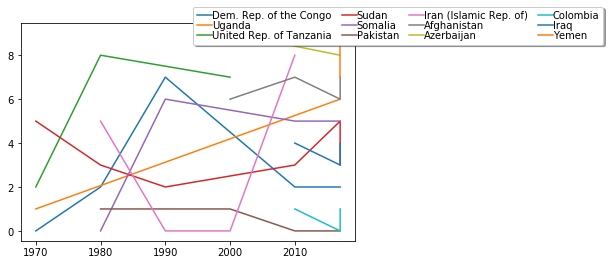

In [43]:
print(posicao_paises_chegaram)

labels = []

for i in posicao_paises_chegaram:
    
    if len(posicao_paises_chegaram[i])>2:
    
        ano = []
        legenda = ''
        posicao = []

        legenda = i

        for j in posicao_paises_chegaram[i]:

            ano.append(j[0])
            posicao.append(j[1])
        labels.append(i)

        plt.plot(ano, posicao)
    
plt.legend(labels, ncol=4, loc='upper left', 
           bbox_to_anchor=[0.5, 1.1], 
           columnspacing=1.0, labelspacing=0.0,
           handletextpad=0.0, handlelength=1.5,
           fancybox=True, shadow=True)
plt.show()

{'Dem. Rep. of the Congo': [(1970, 0), (1980, 2), (1990, 7), (2010, 2), (2017, 2), (2017, 2), (2017, 2)], 'Uganda': [(1970, 1), (2017, 6), (2017, 6)], 'United Rep. of Tanzania': [(1970, 2), (1980, 8), (2000, 7)], 'Senegal': [(1970, 3)], 'China, Macao SAR': [(1970, 4)], 'Sudan': [(1970, 5), (1980, 3), (1990, 2), (2010, 3), (2017, 5), (2017, 3), (2017, 3)], 'India': [(1970, 6)], 'Burundi': [(1970, 7), (1980, 7)], 'Central African Rep.': [(1970, 8)], 'Serbia and Kosovo (S/RES/1244 (1999))': [(1970, 9), (2000, 4)], 'Somalia': [(1980, 0), (1990, 6), (2010, 5), (2017, 5), (2017, 5)], 'Pakistan': [(1980, 1), (1990, 1), (2000, 1), (2010, 0), (2017, 0), (2017, 0)], 'Thailand': [(1980, 4)], 'Iran (Islamic Rep. of)': [(1980, 5), (1990, 0), (2000, 0), (2010, 8)], 'China': [(1980, 6), (1990, 9)], 'Mozambique': [(1980, 9)], 'Malawi': [(1990, 3)], 'Ethiopia': [(1990, 4)], 'United States of America': [(1990, 5), (2000, 5)], 'Guinea': [(1990, 8)], 'Russian Federation': [(2000, 2)], 'Eritrea': [(2000, 3

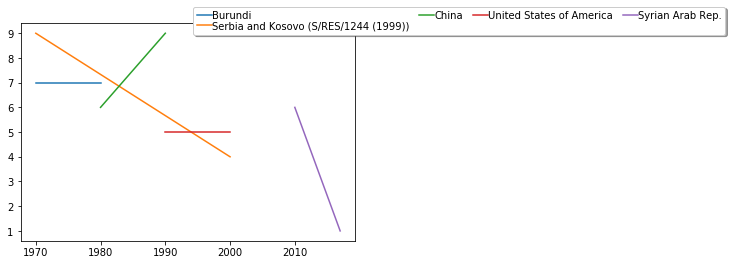

In [44]:
print(posicao_paises_chegaram)

labels = []

for i in posicao_paises_chegaram:
    
    if len(posicao_paises_chegaram[i])==2:
    
        ano = []
        legenda = ''
        posicao = []

        legenda = i

        for j in posicao_paises_chegaram[i]:

            ano.append(j[0])
            posicao.append(j[1])
        labels.append(i)

        plt.plot(ano, posicao)
    
plt.legend(labels, ncol=4, loc='upper left', 
           bbox_to_anchor=[0.5, 1.1], 
           columnspacing=1.0, labelspacing=0.0,
           handletextpad=0.0, handlelength=1.5,
           fancybox=True, shadow=True)
plt.show()

{'Dem. Rep. of the Congo': [(1970, 0), (1980, 2), (1990, 7), (2010, 2), (2017, 2), (2017, 2), (2017, 2)], 'Uganda': [(1970, 1), (2017, 6), (2017, 6)], 'United Rep. of Tanzania': [(1970, 2), (1980, 8), (2000, 7)], 'Senegal': [(1970, 3)], 'China, Macao SAR': [(1970, 4)], 'Sudan': [(1970, 5), (1980, 3), (1990, 2), (2010, 3), (2017, 5), (2017, 3), (2017, 3)], 'India': [(1970, 6)], 'Burundi': [(1970, 7), (1980, 7)], 'Central African Rep.': [(1970, 8)], 'Serbia and Kosovo (S/RES/1244 (1999))': [(1970, 9), (2000, 4)], 'Somalia': [(1980, 0), (1990, 6), (2010, 5), (2017, 5), (2017, 5)], 'Pakistan': [(1980, 1), (1990, 1), (2000, 1), (2010, 0), (2017, 0), (2017, 0)], 'Thailand': [(1980, 4)], 'Iran (Islamic Rep. of)': [(1980, 5), (1990, 0), (2000, 0), (2010, 8)], 'China': [(1980, 6), (1990, 9)], 'Mozambique': [(1980, 9)], 'Malawi': [(1990, 3)], 'Ethiopia': [(1990, 4)], 'United States of America': [(1990, 5), (2000, 5)], 'Guinea': [(1990, 8)], 'Russian Federation': [(2000, 2)], 'Eritrea': [(2000, 3

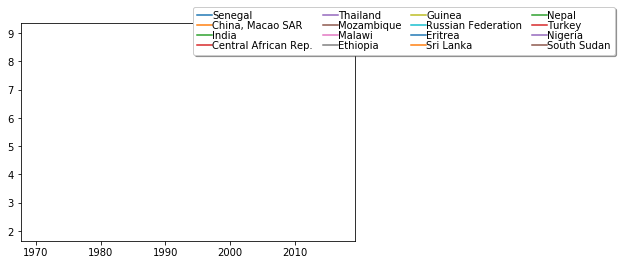

In [45]:
print(posicao_paises_chegaram)

labels = []

for i in posicao_paises_chegaram:
    
    if len(posicao_paises_chegaram[i])<=1:
    
        ano = []
        legenda = ''
        posicao = []

        legenda = i

        for j in posicao_paises_chegaram[i]:

            ano.append(j[0])
            posicao.append(j[1])
        labels.append(i)

        plt.plot(ano, posicao)
    
plt.legend(labels, ncol=4, loc='upper left', 
           bbox_to_anchor=[0.5, 1.1], 
           columnspacing=1.0, labelspacing=0.0,
           handletextpad=0.0, handlelength=1.5,
           fancybox=True, shadow=True)
plt.show()

## Análise posição países que mais saíram pessoas

{'Angola': [(1970, 0), (1980, 2), (1990, 8), (2000, 7), (2017, 7), (2017, 7)], 'Sudan': [(1970, 1), (1990, 5), (2010, 6), (2017, 7), (2017, 3), (2017, 3)], 'Rwanda': [(1970, 2), (1980, 5), (1990, 9)], 'Guinea-Bissau': [(1970, 3)], 'China': [(1970, 4)], 'Tibetan': [(1970, 5)], 'Mozambique': [(1970, 6), (1990, 2)], 'Ethiopia': [(1970, 7), (1980, 0), (1990, 1), (2017, 6), (2017, 6)], 'Dem. Rep. of the Congo': [(1970, 8), (2010, 3), (2017, 2), (2017, 4), (2017, 4)], 'Greece': [(1970, 9)], 'Afghanistan': [(1980, 1), (1990, 0), (2000, 0), (2010, 0), (2017, 3), (2017, 0), (2017, 0)], 'Viet Nam': [(1980, 3), (1990, 6)], 'Cambodia': [(1980, 4)], 'Uganda': [(1980, 6)], 'Chad': [(1980, 7)], 'Zimbabwe': [(1980, 8)], 'Burundi': [(1980, 9), (2000, 9)], 'Iraq': [(1990, 3), (2010, 2), (2017, 4), (2017, 2), (2017, 2)], 'Liberia': [(1990, 4)], 'Somalia': [(1990, 7), (2010, 4), (2017, 6), (2017, 5), (2017, 5)], 'Eritrea': [(2000, 1)], 'Russian Federation': [(2000, 2)], 'Bosnia and Herzegovina': [(2000, 3

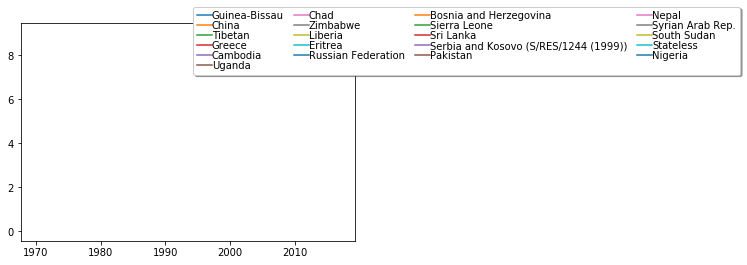

In [46]:

print(posicao_paises_sairam)

labels = []

for i in posicao_paises_sairam:
    
    if len(posicao_paises_sairam[i])==1:
    
        ano = []
        legenda = ''
        posicao = []

        legenda = i

        for j in posicao_paises_sairam[i]:

            ano.append(j[0])
            posicao.append(j[1])
        labels.append(i)

        plt.plot(ano, posicao)
        
    
plt.legend(labels, ncol=4, loc='upper left', 
           bbox_to_anchor=[0.5, 1.1], 
           columnspacing=1.0, labelspacing=0.0,
           handletextpad=0.0, handlelength=1.5,
           fancybox=True, shadow=True)
plt.show()

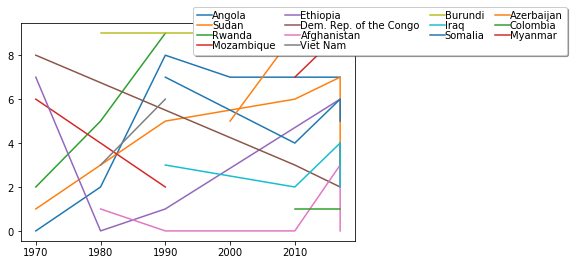

In [47]:
labels = []

for i in posicao_paises_sairam:
    
    if len(posicao_paises_sairam[i])>1:
    
        ano = []
        legenda = ''
        posicao = []

        legenda = i

        for j in posicao_paises_sairam[i]:

            ano.append(j[0])
            posicao.append(j[1])
        labels.append(i)

        plt.plot(ano, posicao)
        
    
plt.legend(labels, ncol=4, loc='upper left', 
           bbox_to_anchor=[0.5, 1.1], 
           columnspacing=1.0, labelspacing=0.0,
           handletextpad=0.0, handlelength=1.5,
           fancybox=True, shadow=True)
plt.show()

## Pagerank dos anos analisados

In [48]:
pr = nx.pagerank(g, alpha=0.9, weight='weight')

dic_pr = {}

for i in pr:
    
    dic_pr[g.nodes[i]['label']] = pr[i]
    
sorted_by_value = sorted(dic_pr.items(), key=lambda kv: kv[1])

sorted_by_value 

[('Sao Tome and Principe', 0.000567214974475326),
 ('Grenada', 0.000567214974475326),
 ('Maldives', 0.000567214974475326),
 ('Andorra', 0.000567214974475326),
 ('Puerto Rico', 0.000567214974475326),
 ('Tuvalu', 0.000567214974475326),
 ('Dominica', 0.000567214974475326),
 ('San Marino', 0.000567214974475326),
 ('Bermuda', 0.000567214974475326),
 ('Kiribati', 0.000567214974475326),
 ('Gibraltar', 0.000567214974475326),
 ('French Polynesia', 0.000567214974475326),
 ('New Caledonia', 0.000567214974475326),
 ('American Samoa', 0.000567214974475326),
 ('Guam', 0.000567214974475326),
 ('Antigua and Barbuda', 0.0005672150153902879),
 ('Seychelles', 0.0005672150855715006),
 ('Monaco', 0.0005672155653031179),
 ('Samoa', 0.0005672157485826367),
 ("Dem. People's Rep. of Korea", 0.0005672159696862608),
 ('Tonga', 0.0005672177071524991),
 ('Mauritius', 0.0005672232238471761),
 ('Palau', 0.0005672235833030121),
 ('British Virgin Islands', 0.000567224371228633),
 ('Vanuatu', 0.0005672283394435017),
 (